In [2]:
from sklearn.cluster import SpectralClustering
from scipy.spatial import distance as dst
from collections import defaultdict
import matplotlib.pyplot as plt
import shapely.geometry as sp
import distinctipy as ds
import pickle as pk
import pandas as pd
import json
import math
import copy

<div>
<font size="4",style="font-family:Ubuntu"> <p> The following cell reads the East_File.csv file and divides all the USA Waypoints in it into 7 zones based on easting(x coordinate) ranges and divides each zone into chunks based on northing (y coordinate) ranges such that each chunk has approx 100k waypoints </p></font><br>
<font size="3">
<b>Input</b> &rarr; East_File.csv - (~53 Million Rows) <br>
<b>Output</b> &rarr; 25 .csv files each containing approx 100k rows/waypoints coordinates in a designated x-y range  </font>
</div>

In [24]:
dfE=pd.read_csv("Outputs/East_File.csv")
zones=[[0,1000000],[1000000,2000000],[2000000,3000000],[3000000,4000000],[4000000,5000000],[5000000,6000000],[6000000,7000000]]
chunks=[[[0,2000000],[2000000,4000000]],[[0,1500000],[1500000,2000000],[2000000,2500000],[2500000,4000000]],[[0,1350000],[1350000,1900000],[1900000,2400000],[2400000,4000000]],[[0,1000000],[1000000,1500000],[1500000,2000000],[2000000,2500000],[2500000,4000000]],[[0,800000],[800000,1250000],[1250000,1700000],[1700000,2150000],[2150000,2700000],[2700000,4000000]],[[0,1750000],[1750000,2300000],[2300000,4000000]],[[0,4000000]]]
zoneNumber=0
for zone in zones:
    chunkNumber=0
    for chunk in chunks[zoneNumber]:
        dfTemp=dfE[(dfE['easting']>=zone[0]) & (dfE['easting']<zone[1]) & (dfE['northing']>=chunk[0]) & (dfE['northing'] < chunk[1])]
        dfTemp=dfTemp.reset_index()
        dfTemp.drop(['index'],axis=1,inplace=True)
        dfTemp.to_csv(f"Outputs/ChunksClustering/Chunk{zoneNumber+1}_{chunkNumber+1}.csv",index=False)
        chunkNumber+=1
    zoneNumber+=1

<div>
<font size="4",style="font-family:Ubuntu"> <p> The following two cells reads the 25 .csv files (Chunks) generated above and applies Spectral Clustering to each, dividing each chunk into 5 Centres resulting in total 125 Centres. The input file(s) is the divided(chunkified) East_File.csv and the output is a single file ->finalUSMap.csv which associates to each waypoint in the input file a number -> 'label' which represents the mapping between a waypoint and a centre. </p></font><br>
<font size="3">
<b>Input</b> &rarr; 25 .csv files (Chunkified East_File.csv) <br>
<b>Output</b> &rarr; finalUSMap.csv </font>
</div>

In [25]:
def getLabel(Chunk):
    sk=SpectralClustering(n_clusters=5 , affinity = "nearest_neighbors")
    label=sk.fit_predict(Chunk)
    return label
def getCVec(label):
    colors=ds.get_colors(5)
    cvec=[colors[i] for i in label]
    return cvec
colors=ds.get_colors(125)
chunks=[["Chunk1_1.csv","Chunk1_2.csv"],["Chunk2_1.csv","Chunk2_2.csv","Chunk2_3.csv","Chunk2_4.csv"],["Chunk3_1.csv","Chunk3_2.csv","Chunk3_3.csv","Chunk3_4.csv"],["Chunk4_1.csv","Chunk4_2.csv","Chunk4_3.csv","Chunk4_4.csv","Chunk4_5.csv"],["Chunk5_1.csv","Chunk5_2.csv","Chunk5_3.csv","Chunk5_4.csv","Chunk5_5.csv","Chunk5_6.csv"],["Chunk6_1.csv","Chunk6_2.csv","Chunk6_3.csv"],["Chunk7_1.csv"]]
FileNames=["Chunk1_1.csv","Chunk1_2.csv","Chunk2_1.csv","Chunk2_2.csv","Chunk2_3.csv","Chunk2_4.csv","Chunk3_1.csv","Chunk3_2.csv","Chunk3_3.csv","Chunk3_4.csv","Chunk4_1.csv","Chunk4_2.csv","Chunk4_3.csv","Chunk4_4.csv","Chunk4_5.csv","Chunk5_1.csv","Chunk5_2.csv","Chunk5_3.csv","Chunk5_4.csv","Chunk5_5.csv","Chunk5_6.csv","Chunk6_1.csv","Chunk6_2.csv","Chunk6_3.csv","Chunk7_1.csv"]
for File in FileNames:
    df=pd.read_csv(f"Outputs/ChunksClustering/{File}")
    label=getLabel(df)
    cvec=getCVec(label)
    df['label']=label
    df.to_csv(f"ChunksClustering/{File}",index=False)

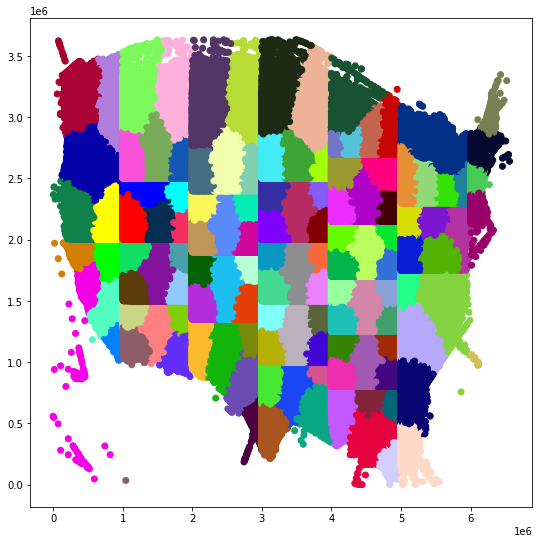

In [45]:
centre_label=0
allChunksDf=pd.DataFrame()
for chunk in chunks:
    chunkDataFrame=pd.DataFrame()
    for subChunk in chunk:
        chunkDf=pd.read_csv(f"ChunksClustering/{subChunk}")
        chunkDf['label']+=5*centre_label
        chunkDataFrame=pd.concat([chunkDataFrame,chunkDf])
        centre_label+=1
    allChunksDf=pd.concat([allChunksDf,chunkDataFrame])
labels=list(allChunksDf['label'])
cvec = [colors[label] for label in labels]
plt.figure(figsize =(9, 9))
plt.scatter(allChunksDf['easting'], allChunksDf['northing'], c = cvec)
allChunksDf.to_csv("Outputs/finalUSMap.csv",index=False)
plt.savefig(f"Outputs/USMap.png")

<div>
<font size="4",style="font-family:Ubuntu"> <p> The following two cells reads the finalUSMap.csv file generated above and applies Spectral Clustering to each one of the 125 centres, dividing each centre into 10 sectors resulting in total 1250 sectors. The input file(s) is the divided(chunkified) finalUSMap.csv and the output is a single file ->US_SectorMap.csv which associates to each waypoint in the input file a number -> 'sector' which represents the mapping between a waypoint and a sector. </p></font><br>
<font size="3">
<b>Input</b> &rarr; finalUSMap.csv <br>
<b>Output</b> &rarr; US_SectorMap.csv </font>
</div>

In [5]:
def getLabelForSector(Chunk):
    sk=SpectralClustering(n_clusters=10 , affinity = "nearest_neighbors")
    label=sk.fit_predict(Chunk)
    return label

dfUSmap=pd.read_csv("Outputs/finalUSMap.csv")

labelno=0
dfSector=pd.DataFrame()
while labelno<125:    
    dftemp=dfUSmap[dfUSmap['label']==labelno]
    dftemp=dftemp.reset_index()
    dftemp.drop(['index'],axis=1,inplace = True)
    label=getLabelForSector(dftemp)
    label=list(map(lambda x:x+(10*labelno),label))
    dftemp['sector']=label
    dfSector=pd.concat([dfSector,dftemp])
    labelno+=1
dfSector.to_csv("Outputs/US_SectorMap.csv",index=False)

<div>
<font size="4",style="font-family:Ubuntu"> <p> The following cell plots reads US_SectorMap.csv and plots all the 1250 sectors. </p></font><br>
<font size="3">
<b>Input</b> &rarr; US_SectorMap.csv <br>
<b>Output</b> &rarr; USMapSectors.png which is a plot of all 1250 sectors </font>
</div>

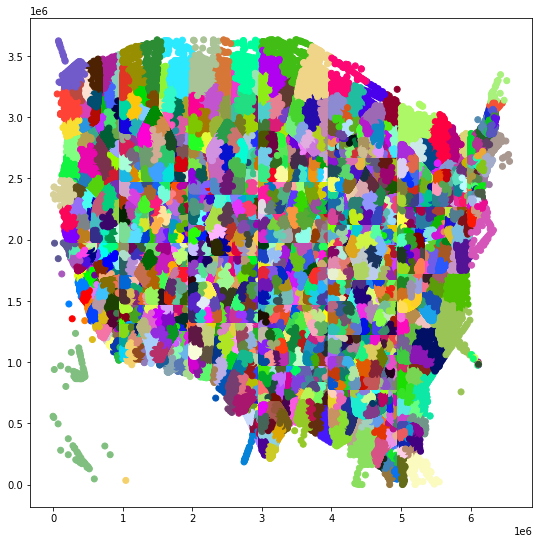

In [8]:
colors=ds.get_colors(1250)
dfSector=pd.read_csv("Outputs/US_SectorMap.csv")
labels=list(dfSector['sector'])
cvec = [colors[label] for label in labels]
plt.figure(figsize =(9, 9))
plt.scatter(dfSector['easting'], dfSector['northing'], c = cvec)
plt.savefig("Outputs/USMapSectors.png")

<div>
<font size="4",style="font-family:Ubuntu"> <p> The following cell gives a mapping between the sectors themselves and the centre to which they belong to, by outputting a dict of dict wherein the first index marks the max X coordinate and the second index marks the max Y coordinate.<br> For example, SectorChunkDict[1000000][2000000]=[0,1,2,3,4,...,49] means that sectors 0 to 49 are bounded by  X = [0,1000000] and Y = [0,2000000]    </p></font><br>
<font size="3">
<b>Input</b> &rarr; - <br>
<b>Output</b> &rarr; SectorChunkDict.pkl </font>
</div>

In [11]:
ZoneDict=dict()
for zone in range(1000000,8000000,1000000):
    ZoneDict[zone]=[]
Centres=[[2000000,4000000],[1500000,2000000,2500000,4000000],[1350000,1900000,2400000,4000000],[1000000,1500000,2000000,2500000,4000000],[800000,1250000,1700000,2150000,2700000,4000000],[1750000,2300000,4000000],[4000000]]
CurrentZone=0
for zone in range(len(ZoneDict)):
    CurrentZone+=1000000
    for centre in Centres[zone]:
        tempDict=dict()
        tempDict[centre]=[]
        ZoneDict[CurrentZone].append(tempDict)
CopyDict=copy.deepcopy(ZoneDict)
newDict=defaultdict(dict)
for zone in CopyDict:
    for chunk in CopyDict[zone]:
        inner_key=[key for key in chunk.keys()][0]
        newDict[zone][inner_key]=[]
maxSector=0
for Zone in newDict:
    for Chunk in newDict[Zone]:
        newDict[Zone][Chunk]+=[sectorNumber for sectorNumber in range(maxSector,maxSector+50)]
        maxSector+=50
SectorChunkDict = open("Outputs/SectorChunkDict.pkl", "wb")
pk.dump(newDict,SectorChunkDict)
SectorChunkDict.close()

<div>
<font size="4",style="font-family:Ubuntu"> <p> The following cell implements Chan's Algorithm which finds the convex hull given a set of points</p></font><br>
<font size="3">
<b>Input</b> &rarr; Set of points <br>
<b>Output</b> &rarr; Convex hull </font>
</div>

In [8]:
class Point:
       def __init__(self,x,y):
            self.x=x
            self.y=y
def crossProduct(O,A,B):
     return (A.x - O.x) * (B.y - O.y)- (A.y - O.y) * (B.x - O.x)
def convexHull(points):
    n=len(points)
    k=0
    if n<=3:
        return points
    ans=[None]*(2*n)
    points=sorted(points,key=lambda o:(o.x,o.y))
    for i in range(n):
        while k >= 2 and crossProduct(ans[k - 2], ans[k - 1], points[i]) <= 0:
            k-=1
        ans[k]=points[i]
        k+=1
    t=k+1
    for i in range(n-1,0,-1):
        while k >= t and crossProduct(ans[k - 2],ans[k - 1], points[i - 1]) <= 0:
            k-=1
        ans[k] = points[i - 1]
        k+=1
    ans=ans[:k-1]
    return ans

<div>
<font size="4",style="font-family:Ubuntu"> <p> The following cell reads US_SectorMap.csv and applies Chan's Algorithm to find the convex hull and maps each sector to the convex hull corresponding to it</p></font><br>
<font size="3">
<b>Input</b> &rarr; US_SectorMap.csv <br>
<b>Output</b> &rarr; ConvexDict.pkl which maps sector to its convex hull </font>
</div>

In [40]:
df=pd.read_csv("Outputs/US_SectorMap.csv")
sectorBoundaryMap=dict()
sectorNumber=0
while sectorNumber<1250:
    dfSector=df[df["sector"]==sectorNumber]
    easting=list(dfSector['easting'])
    northing=list(dfSector['northing'])
    v=list(zip(easting,northing))
    v=list(map(lambda p:Point(p[0],p[1]),v))
    ans=convexHull(v)
    ans=list(map(lambda p:(p.x,p.y),ans))
    sectorBoundaryMap[sectorNumber]=ans
    sectorNumber+=1
ConvexDict = open("Outputs/ConvexDict.pkl", "wb")
pk.dump(sectorBoundaryMap, ConvexDict)
ConvexDict.close()

<div>
<font size="4",style="font-family:Ubuntu"> <p> The following cell reads the Airports.csv which has the corresponding information about all the relevant airports in the USA and maps it to its corresponding sector in the sector map we have created </p></font><br>
<font size="3">
<b>Input</b> &rarr; ConvexDict.pkl,Airports.csv <br>
<b>Output</b> &rarr; airportSectorDict.pkl </font>
</div>

In [8]:
airportToSector=dict()
ConvexDict= pk.load(open("Outputs/ConvexDict.pkl", "rb"))
dfAirFinal=pd.read_csv("Outputs/Airports.csv")
airportsICAO=dfAirFinal['Airport_ICAO_Code']
x=dfAirFinal['Easting']
y=dfAirFinal['Northing']
for airportIndex in range(len(airportsICAO)):
    ICAO=airportsICAO[airportIndex]
    found=False
    AssignedSector=0
    point=sp.Point((x[airportIndex],y[airportIndex]))
    distance=sp.Polygon(ConvexDict[0]).distance(point)
    for i in range(0,1250):
        if len(ConvexDict[i]) < 3:
            continue
        doesContain=sp.Polygon(ConvexDict[i]).contains(point)
        if doesContain:
            airportToSector[ICAO]=i
            found=True
            break
        if(len(ConvexDict[i])>2):
            t=sp.Polygon(ConvexDict[i]).distance(point)
            if(t<distance):
                distance=t
                AssignedSector=i
    if(not found):
        airportToSector[ICAO]=AssignedSector
filehandler = open("Outputs/airportSectorDict.pkl","wb")
pk.dump(airportToSector,filehandler)
filehandler.close()

<div>
<font size="4",style="font-family:Ubuntu"> <p> The following cell reads the Airports.csv and the airportSectorDict.pkl to output a file AirportFileForFrontend.txt which has all the airports with thier corresponding sector,ICAO code, and cartesian coordinates </p></font><br>
<font size="3">
<b>Input</b> &rarr; airportSectorDict.pkl,Airports.csv <br>
<b>Output</b> &rarr; AirportFileForFrontend.txt </font>
</div>

In [3]:
dfAirFinal=pd.read_csv("Outputs/Airports.csv")
airportSectorDict = pk.load(open("Outputs/airportSectorDict.pkl", "rb"))
outputFile=open("Outputs/AirportFileForFrontend.txt","w")
for index,row in dfAirFinal.iterrows():
    icao=row["Airport_ICAO_Code"]
    name=row["Airport_Name"]
    sector=str(airportSectorDict[icao])
    easting=row["Easting"]
    northing=row["Northing"]
    state=row["State"]
    line=f"{name},{state},{sector},{icao},{easting},{northing}\n"
    outputFile.write(line)
outputFile.close()

<div>
<font size="4",style="font-family:Ubuntu"> <p> The following cell reads the Airports.csv and generates a dictionary mapping each airport to its coordinates which is used in the simulator</p></font><br>
<font size="3">
<b>Input</b> &rarr; Airports.csv <br>
<b>Output</b> &rarr; airportCoordDict.pkl </font>
</div>

In [5]:
dfAirFinal=pd.read_csv("Outputs/Airports.csv")
airportCoordDict = dict()
for index,row in dfAirFinal.iterrows():
    airportCoordDict[row["Airport_ICAO_Code"]]=(row["Easting"],row["Northing"])
filehandler = open("Outputs/airportCoordDict.pkl","wb")
pk.dump(airportCoordDict,filehandler)
filehandler.close()

<div>
<font size="4",style="font-family:Ubuntu"> <p> The following cell reads ConvexDict.pkl and US_SectorMap.csv, Airports.csv and gives all visual representation of all the convex hulls with the airports represented within each hull/sector </p></font><br>
<font size="3">
<b>Input</b> &rarr; ConvexDict.pkl , US_SectorMap.csv, Airports.csv <br>
<b>Output</b> &rarr; NodeMap.png is a visual representation of all the convex hulls</font>
</div>

In [9]:
output = pk.load(open("Outputs/ConvexDict.pkl", "rb"))
airports= pd.read_csv("Outputs/Airports.csv")
df=pd.read_csv("Outputs/US_SectorMap.csv")
xAir=airports['Easting']
yAir=airports['Northing']
airportList=list(airports["Airport_ICAO_Code"])
sectorNumber=0
dpi=96
fig=plt.figure(figsize=(200,200),dpi=dpi)
while sectorNumber<1250:
    x=output[sectorNumber]
    x1=list(map(lambda p:p[0],x))
    y1=list(map(lambda p:p[1],x))
    x2=list(df[df['sector']==sectorNumber]['easting'])
    y2=list(df[df['sector']==sectorNumber]['northing'])
    x3=sorted(x1)
    y3=sorted(y1)
    xmid=(x3[0]+x3[-1])/2
    ymid=(y3[0]+y3[-1])/2
    plt.text(xmid,ymid,f"{sectorNumber}",fontsize=60)
    plt.plot(x1,y1,'r')
    plt.plot([x1[0],x1[-1]],[y1[0],y1[-1]],'r')
    sectorNumber+=1
plt.scatter(xAir,yAir,marker='o' , s=3000)
for i, txt in enumerate(airportList):
    plt.annotate(txt, (xAir[i], yAir[i]),fontsize=70,color ="red")
plt.savefig("Outputs/NodeMap.png",dpi=dpi)